In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [3]:
import numpy as np
from tqdm import tqdm
from pathlib import Path
import openslide
import pandas as pd

In [4]:
from fastai.callbacks.csv_logger import CSVLogger

In [5]:
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric, PascalVOCMetricByDistance

In [6]:
slides_train = list(set(['BAL Promyk Spray 4.svs',
                         'BAL AIA Blickfang Luft.svs']))

slides_val = list(set(['BAL 1 Spray 2.svs', 
                         'BAL Booker Spray 3.svs',
                         'BAL Bubi Spray 1.svs', 
                         'BAL cent blue Luft 2.svs']))

labels = ['Mastzellen', "Makrophagen", "Neutrophile", "Eosinophile", "Lymohozyten"]

In [7]:
experiment_name = "Asthma-L0"

In [8]:
annotations_path = Path("../Statistics/Asthma_Annotations.pkl")
annotations = pd.read_pickle(annotations_path)

annotations = annotations[annotations["class"].isin(labels)]
annotations_train = annotations[annotations["image_name"].isin(slides_train)]
annotations_val = annotations[annotations["image_name"].isin(slides_val)]
annotations_train.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor
21105,140917,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14371, 'x2': 14435, 'y1': 14738, 'y2': ...",2c2f610e-f4f7-4e05-8236-ffa28418550d,10,False,None
21106,140918,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14066, 'x2': 14152, 'y1': 14692, 'y2': ...",bcf159fc-2a41-4a69-a4cd-9b48da8fc663,10,False,None
21107,140919,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14377, 'x2': 14451, 'y1': 14646, 'y2': ...",f5e247d5-9c38-4e22-9329-56805024cf83,10,False,None
21108,140920,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14304, 'x2': 14384, 'y1': 14600, 'y2': ...",f68910d0-eb8f-4715-ad8d-accd060efff1,10,False,None
21109,140921,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14318, 'x2': 14402, 'y1': 14544, 'y2': ...",013f3fc1-b603-41ce-8357-e446db2c9a14,10,False,None


In [9]:
annotations["width"] = [vector["x2"] - vector["x1"] for vector in annotations["vector"]]
annotations["height"] = [vector["y2"] - vector["y1"] for vector in annotations["vector"]]
annotations["scale"] = annotations["width"] / annotations["height"]

<AxesSubplot:xlabel='width', ylabel='height'>

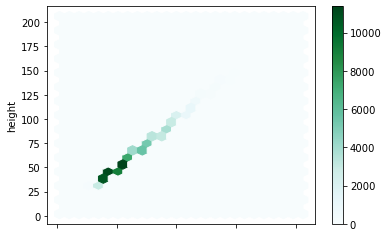

In [10]:
annotations.plot.hexbin(x='width', y='height', gridsize=25) #C='scale', 

In [11]:
slides_path = Path("../Slides")
files = {slide.name: slide for slide in slides_path.rglob("*.svs") if slide.name in slides_train + slides_val}
files

{'BAL 1 Spray 2.svs': WindowsPath('../Slides/BAL 1 Spray 2.svs'),
 'BAL AIA Blickfang Luft.svs': WindowsPath('../Slides/BAL AIA Blickfang Luft.svs'),
 'BAL Booker Spray 3.svs': WindowsPath('../Slides/BAL Booker Spray 3.svs'),
 'BAL Bubi Spray 1.svs': WindowsPath('../Slides/BAL Bubi Spray 1.svs'),
 'BAL cent blue Luft 2.svs': WindowsPath('../Slides/BAL cent blue Luft 2.svs'),
 'BAL Promyk Spray 4.svs': WindowsPath('../Slides/BAL Promyk Spray 4.svs')}

In [12]:
size = 1024 
level = 0
bs = 16
train_images = 500
val_images = 500

In [13]:
train_files = []
val_files = []

In [14]:
for image_name in annotations_train["image_name"].unique():
    
    annotations = annotations_train[annotations_train["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    train_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))
    
for image_name in annotations_val["image_name"].unique():
    
    annotations = annotations_val[annotations_val["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    val_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))

train_files = list(np.random.choice(train_files, train_images))
valid_files = list(np.random.choice(val_files, val_images))

In [15]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      #max_lighting=0.0,
                      #max_zoom=1.,
                      #max_warp=0.0,
                      #p_affine=0.5,
                      #p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )

In [16]:
def get_y_func(x):
    return x.y

In [17]:
train =  ObjectItemListSlide(train_files, path=slides_path)
valid = ObjectItemListSlide(valid_files, path=slides_path)
item_list = ItemLists(slides_path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate, num_workers=0).normalize()

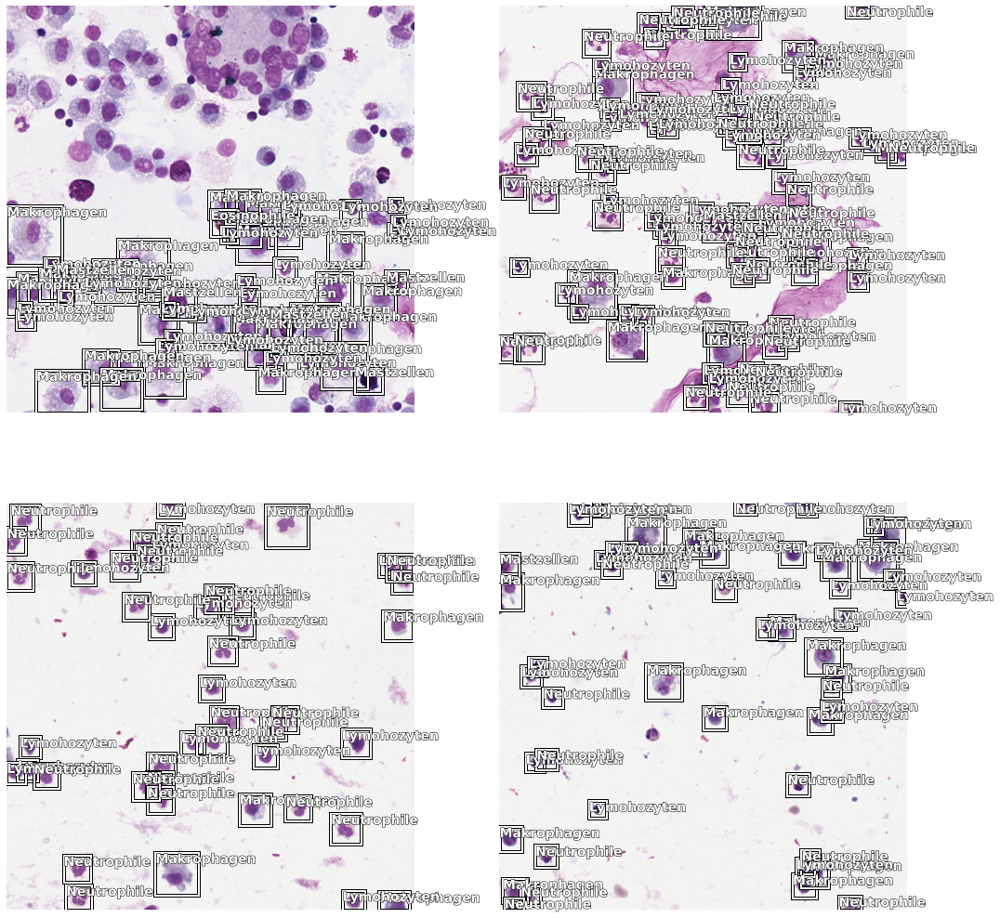

In [18]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

In [19]:
scales = [.8, .9, 1, 1.1]
anchors = create_anchors(sizes=[(64, 64), (32,32)], ratios=[1], scales=scales)

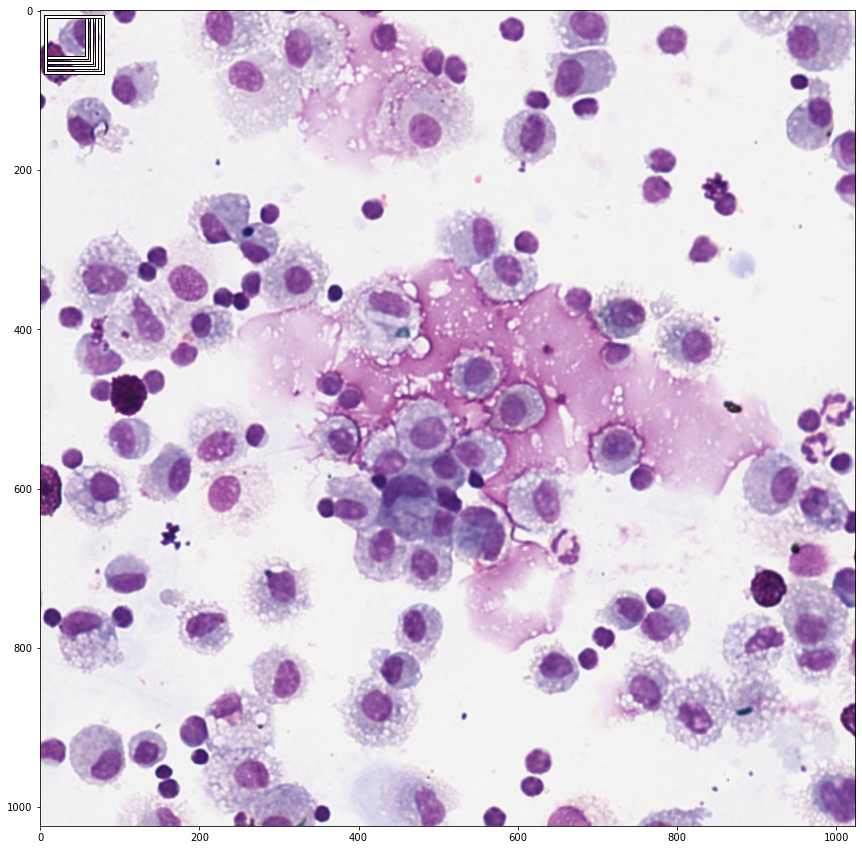

In [20]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:len(scales)]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

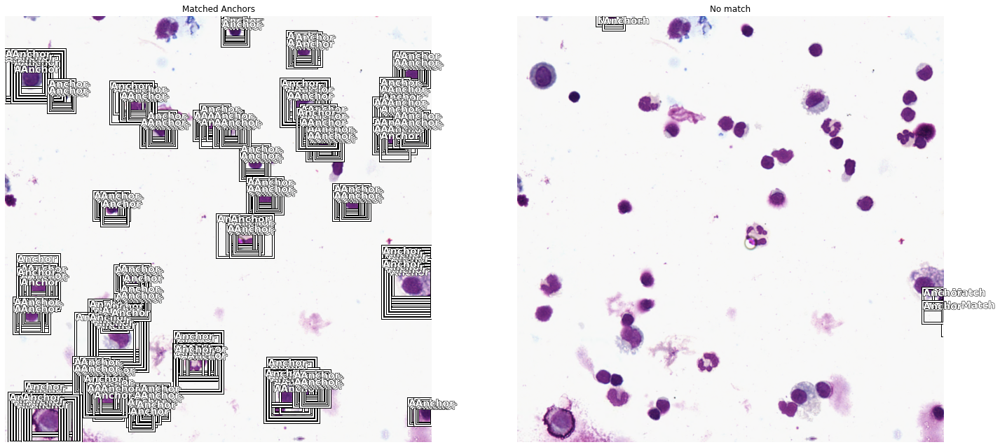

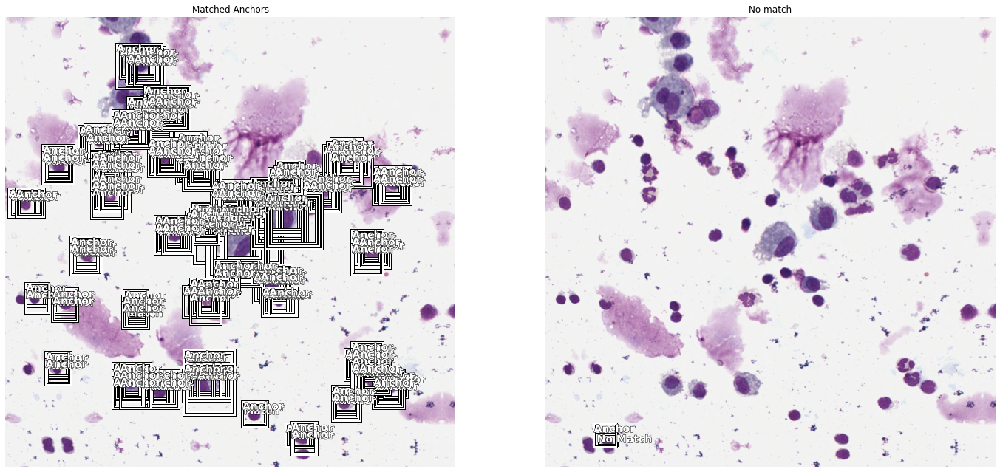

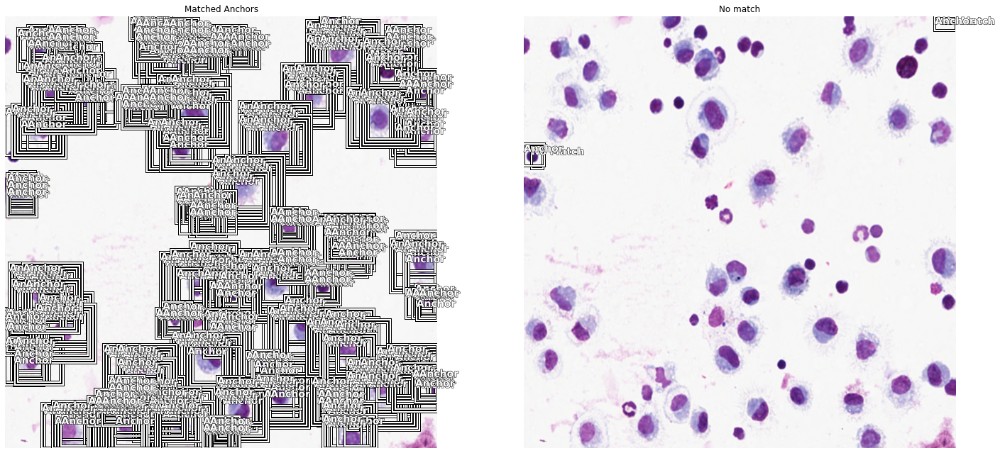

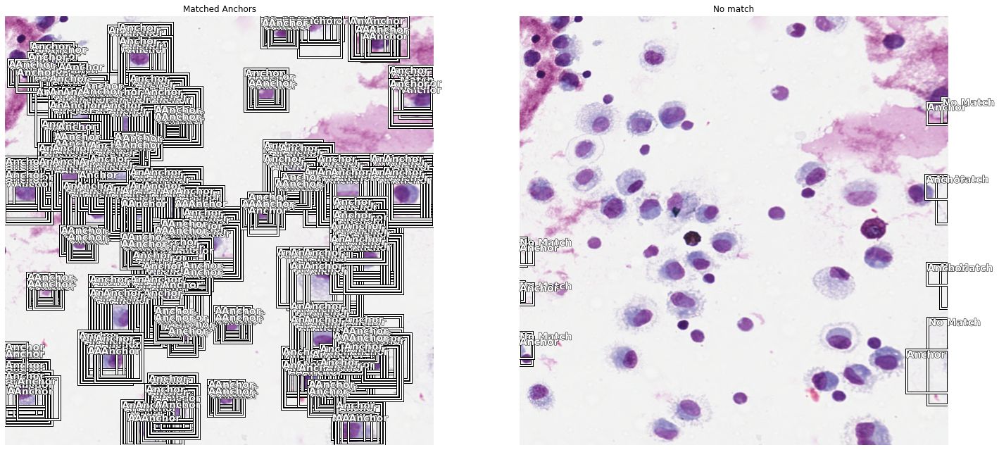

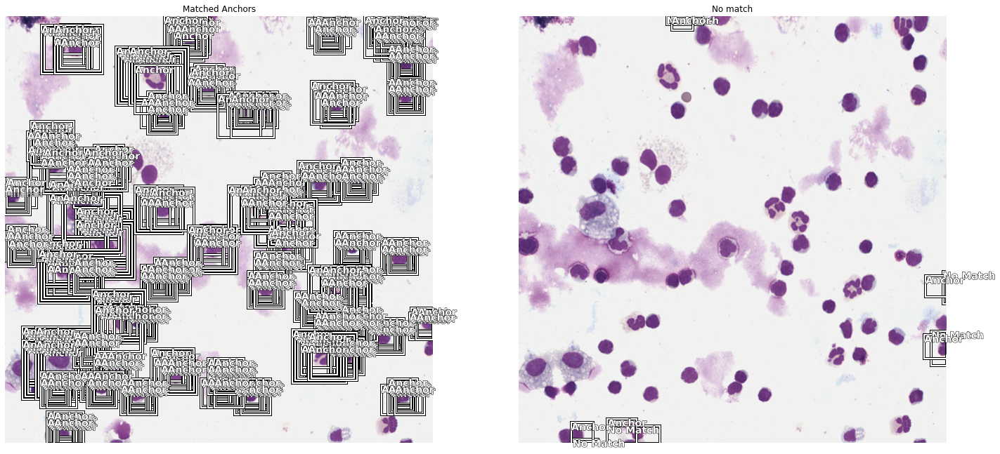

...

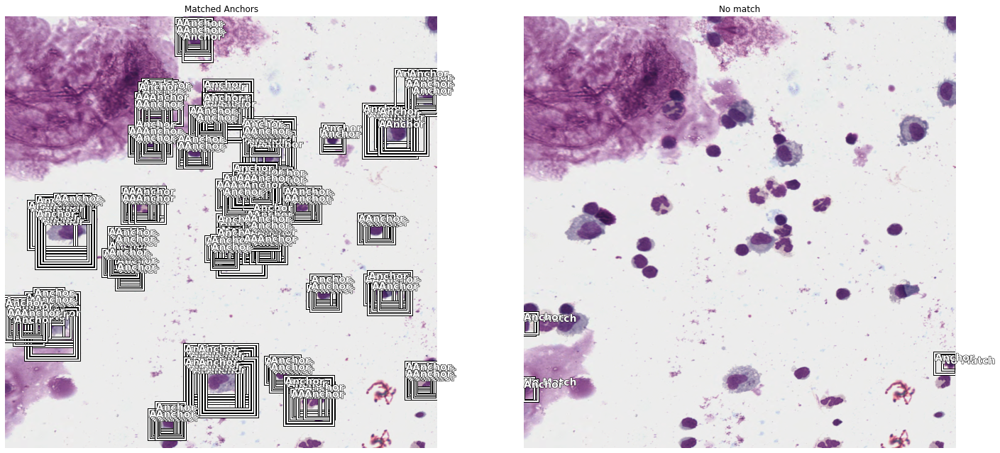

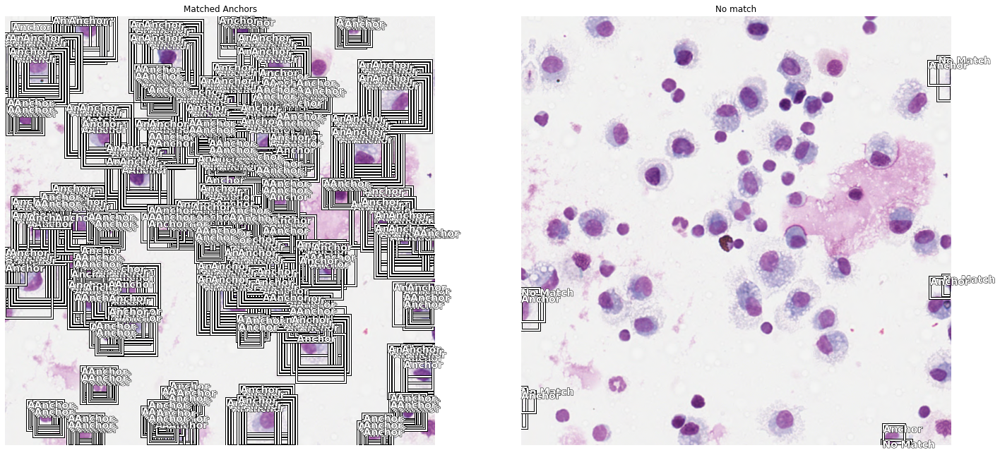

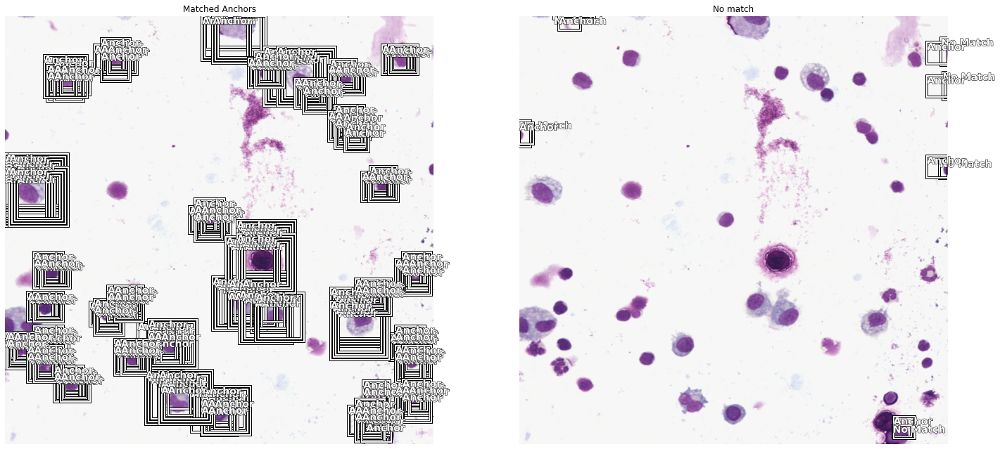

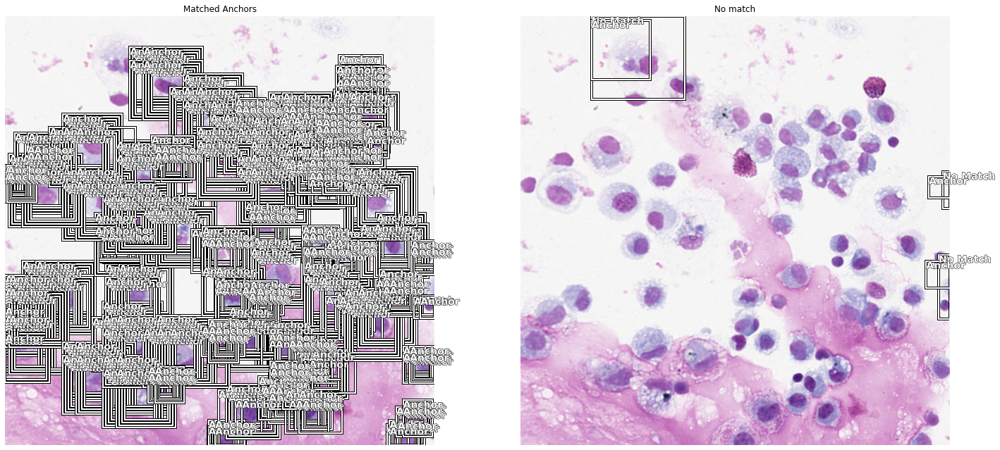

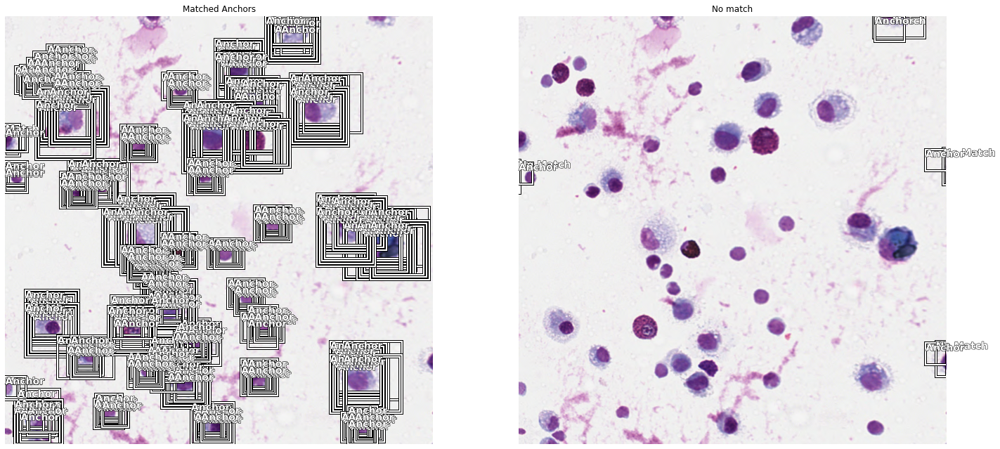

In [21]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(24, 24))

In [22]:
crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=len(scales), sizes=[64, 32], chs=128, final_bias=-4., n_conv=2)

In [23]:
data.train_ds.y.classes[1:]

['Eosinophile', 'Lymohozyten', 'Makrophagen', 'Mastzellen', 'Neutrophile']

In [24]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i) for i in data.train_ds.y.classes[1:]], radius=40)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc])

In [25]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [26]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,1.306846,1.370164,0.216992,0.323718,1.046446,0.013333,0.134495,0.458506,0.048381,0.430244,13:52
1,0.709088,1.075456,0.354779,0.216487,0.858969,0.111724,0.336589,0.586956,0.281604,0.457023,19:40
2,0.484567,0.946977,0.375761,0.205576,0.741401,0.034884,0.435410,0.602640,0.334835,0.471035,18:27


In [27]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.285409,1.465163,0.385434,0.239861,1.225301,0.145498,0.471986,0.588187,0.306779,0.414722,18:29
1,0.291991,0.719700,0.486676,0.221714,0.497987,0.434272,0.413748,0.597247,0.320310,0.667804,16:56
2,0.303675,0.790449,0.390610,0.169012,0.621437,0.083333,0.469380,0.660130,0.431980,0.308227,18:52
3,0.280942,1.022266,0.520648,0.199593,0.822673,0.465739,0.505830,0.656286,0.412744,0.562644,18:56
4,0.247169,0.797099,0.501418,0.124966,0.672133,0.352045,0.511040,0.566112,0.445564,0.632328,18:42
5,0.220789,0.760007,0.595444,0.143205,0.616802,0.648462,0.500287,0.635545,0.495859,0.697065,19:29
6,0.202784,0.719770,0.570510,0.140947,0.578823,0.599018,0.502866,0.613336,0.491912,0.645416,23:00
7,0.187149,0.634693,0.602845,0.126946,0.507747,0.584655,0.482461,0.669420,0.612016,0.665673,28:13
8,0.174370,0.798742,0.586156,0.108461,0.690282,0.500600,0.502638,0.676018,0.572377,0.679147,22:44
9,0.164288,0.609975,0.582948,0.114053,0.495921,0.499650,0.512479,0.675317,0.536522,0.690771,18:14


In [31]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.150910,0.505655,0.577032,0.109922,0.395733,0.515578,0.491012,0.649448,0.567310,0.661813,13:43
1,0.164105,0.837476,0.584559,0.154260,0.683216,0.669140,0.472031,0.613727,0.474382,0.693515,12:50
2,0.195383,0.709248,0.506133,0.168373,0.540875,0.348746,0.474180,0.628758,0.515339,0.563644,12:59
3,0.203754,0.531415,0.535129,0.128381,0.403033,0.516166,0.403807,0.654500,0.468117,0.633054,14:21
4,0.195193,0.928375,0.582142,0.176067,0.752307,0.577389,0.474411,0.635023,0.542415,0.681473,19:46
5,0.187453,0.607849,0.602553,0.100843,0.507006,0.683762,0.497514,0.582148,0.603453,0.645889,19:47
6,0.172550,1.139591,0.612428,0.138429,1.001163,0.660339,0.485033,0.653784,0.604480,0.658502,13:21
7,0.161670,0.622332,0.555136,0.101666,0.520666,0.507376,0.499202,0.618623,0.507077,0.643402,13:19
8,0.151796,0.572613,0.604406,0.107781,0.464832,0.681818,0.493452,0.647650,0.565311,0.633799,13:09
9,0.143372,0.573147,0.609399,0.101404,0.471743,0.661601,0.491485,0.646511,0.591746,0.655650,13:22


In [32]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.134332,1.178320,0.572802,0.102561,1.075759,0.557048,0.507155,0.603616,0.569176,0.627018,12:59
1,0.142855,0.620343,0.597817,0.109612,0.510731,0.622740,0.485566,0.648356,0.543333,0.689091,12:00
2,0.159558,0.811175,0.586668,0.109237,0.701938,0.672729,0.493810,0.580846,0.518274,0.667683,13:00
3,0.174440,0.618778,0.605576,0.140147,0.478631,0.613109,0.486977,0.616158,0.585576,0.726062,13:16
4,0.166438,0.684811,0.563940,0.163153,0.521658,0.509547,0.435634,0.682627,0.498561,0.693328,11:49
5,0.163319,0.567455,0.565785,0.117747,0.449709,0.594008,0.494344,0.658563,0.491312,0.590699,12:44
6,0.153349,0.622894,0.583061,0.098621,0.524273,0.576461,0.462666,0.690832,0.532997,0.652349,12:16
7,0.147156,0.602497,0.596269,0.088709,0.513788,0.638129,0.462810,0.662537,0.567221,0.650649,12:11
8,0.138194,0.551714,0.586423,0.091390,0.460324,0.568182,0.496730,0.652491,0.565834,0.648878,13:04
9,0.132606,0.889870,0.596094,0.093907,0.795963,0.613620,0.484645,0.666306,0.568605,0.647293,12:30


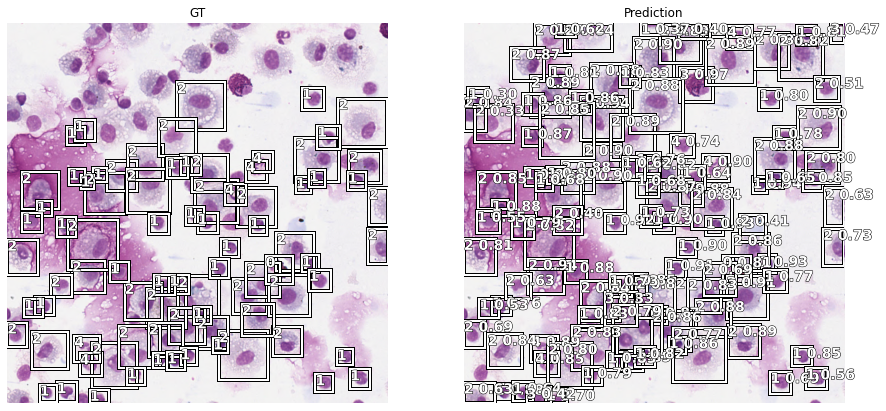

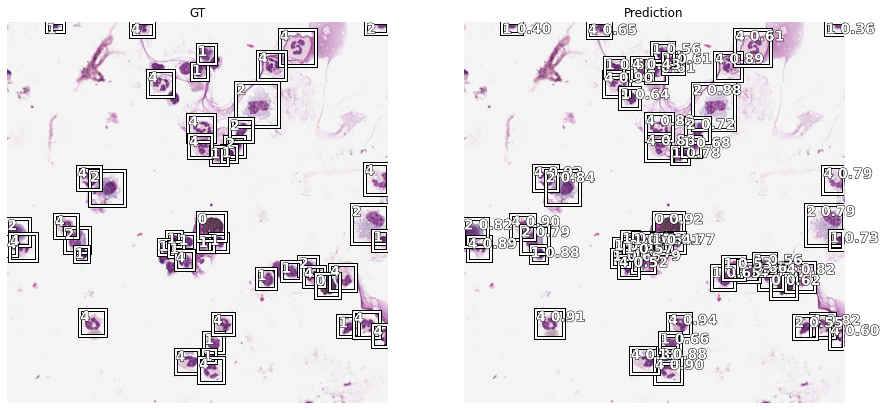

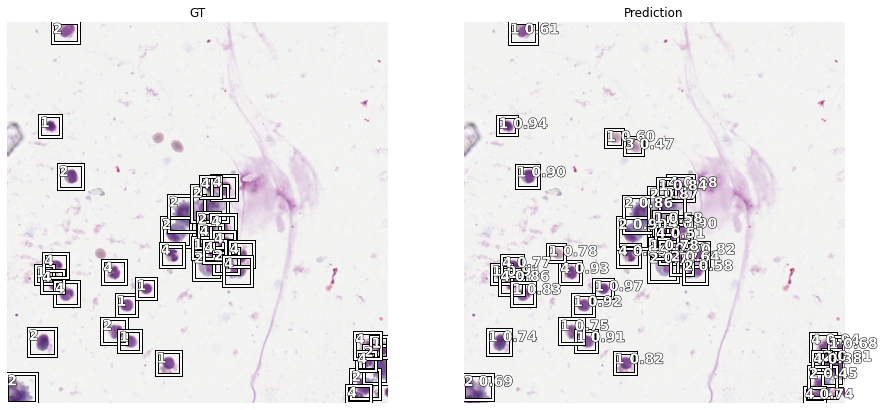

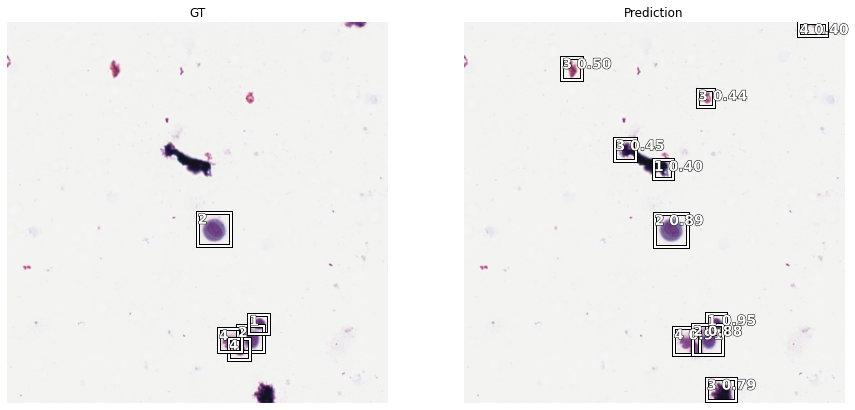

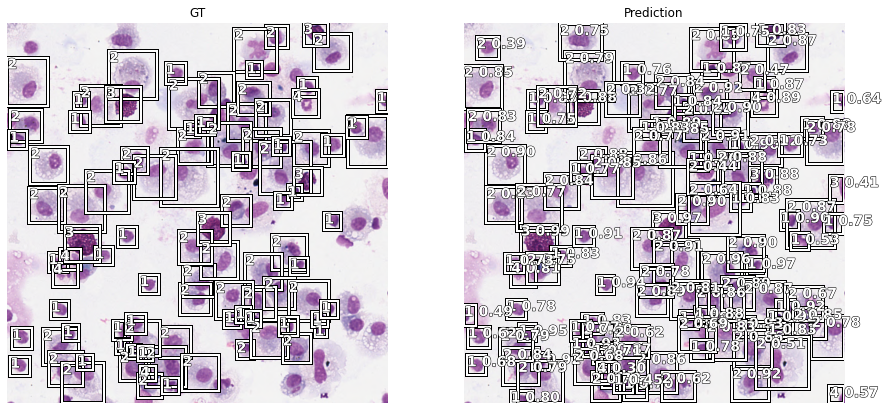

In [28]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2)

In [29]:
data.c

6

In [37]:
import pickle

stats = {"anchors": anchors,
         "mean": to_np(data.stats[0]),
         "std": to_np(data.stats[1]),
         "size": size,
         "n_classes": data.c,
         "n_anchors": len(scales),
         "sizes": [64, 32],
         "chs": 128,
         "encoder": "RN-18",
         "n_conv": 2,
         "level": 0,
         "model": get_model(learn.model).state_dict()
        }

torch.save(stats, "{}.p".format(experiment_name))

In [35]:
data.classes 

['background',
 'Eosinophile',
 'Lymohozyten',
 'Makrophagen',
 'Mastzellen',
 'Neutrophile']